In [1]:
import pandas as pd
import pickle
from streamlit_utils import *
import plotly.express as px

2023-12-01 10:12:49.460 WARNING streamlit.runtime.caching.cache_data_api: No runtime found, using MemoryCacheStorageManager


In [2]:
model = pickle.load(open('long_training_model.pkl', 'rb'))
# Make a prediction for the next year for a 100m2 house with 4 rooms in 77078 and plot the evolution of the price of property

fh = pd.date_range(start="2023-01-01", end="2024-01-01", freq="M")

forecast = model.predict(
    pd.DataFrame({"new_commune": [77078]*len(fh), "Type local": ["Maison"]*len(fh), "Surface Totale": [100]*len(fh), "Nombre pieces principales": [4]*len(fh), "Date mutation": fh}))
forecast = pd.Series(forecast, index=fh)
px.line(forecast, title="Evolution of the price of property in 77078 for a 100m2 house with 4 rooms")

In [39]:
model

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   RobustScaler())]),
                                                  ['Surface Totale',
                                                   'Nombre pieces '
                                                   'principales']),
                                                 ('cat',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['new_commune',
                                                   'Type local']),
                                                 ('date',
                                                  FunctionTransformer(func=<function date_convert_to_timestamp at 0x11fe935b0>),
                                                  ['Date mutation'])])),
                ('regressor',
                 RandomForestRegressor(n_jobs=-1, random_state=42))],
         verbose=True)

In [3]:
# For every commune, compute the trend of the price of property for a 100m2 house with 4 rooms

seine_et_marne = pd.read_csv("data/seine_et_marne.csv")
seine_et_marne

,No disposition,Date mutation,Nature mutation,Valeur fonciere,No voie,Type de voie,Code voie,Voie,Code postal,Commune,...,No plan,Nombre de lots,Code type local,Type local,Surface reelle bati,Nombre pieces principales,Nature culture,Surface terrain,new_commune,Surface Totale
0,1,2018-07-02,Vente,100000.0,92.0,RUE,1610,SAINT DENIS,77400.0,LAGNY-SUR-MARNE,...,417,1,2.0,Appartement,22.0,1,NaN,NaN,77243,22.0
1,1,2018-07-02,Vente,262000.0,NaN,NaN,B025,SAINT GERMAIN,77860.0,SAINT-GERMAIN-SUR-MORIN,...,133,0,NaN,Terrain,NaN,0,S,8.0,77413,8.0
2,1,2018-07-02,Vente,262000.0,5.0,RUE,0520,LOUIS DOUVIZIE,77860.0,SAINT-GERMAIN-SUR-MORIN,...,132,0,1.0,Maison,84.0,3,S,110.0,77413,194.0
3,1,2018-07-02,Vente,262000.0,NaN,NaN,B025,SAINT GERMAIN,77860.0,SAINT-GERMAIN-SUR-MORIN,...,131,0,NaN,Terrain,NaN,0,S,297.0,77413,297.0
4,1,2018-07-02,Vente,262000.0,NaN,NaN,B025,SAINT GERMAIN,77860.0,SAINT-GERMAIN-SUR-MORIN,...,130,0,NaN,Terrain,NaN,0,S,8.0,77413,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
381364,1,2023-06-30,Vente,12500.0,28.0,RUE,1610,SAINT DENIS,77400.0,LAGNY-SUR-MARNE,...,145,1,3.0,Dépendance,0.0,0,NaN,NaN,77243,0.0
381365,1,2023-06-30,Vente,790889.0,245.0,AV,0128,DE LA GRANDE HAIE,77100.0,MAREUIL-LES-MEAUX,...,520,0,4.0,Local industriel. commercial ou assimilé,1663.0,0,S,2630.0,77276,4293.0
381366,1,2023-06-30,Vente,790889.0,245.0,AV,0128,DE LA GRANDE HAIE,77100.0,MAREUIL-LES-MEAUX,...,520,0,4.0,Local industriel. commercial ou assimilé,0.0,0,S,2630.0,77276,2630.0
381367,1,2023-06-30,Vente,790889.0,NaN,AV,0128,DE LA GRANDE HAIE,77100.0,MAREUIL-LES-MEAUX,...,523,0,NaN,Terrain,NaN,0,S,1363.0,77276,1363.0


In [4]:
from tqdm.notebook import tqdm
from sklearn.linear_model import LinearRegression

fh = pd.date_range(start="2022-01-01", end="2023-07-01", freq="M")

results = pd.DataFrame(columns=["new_commune", "trend"])

for commune in tqdm(seine_et_marne["new_commune"].unique()):
    to_predictDf = pd.DataFrame({"new_commune": [commune]*len(fh), "Type local": ["Maison"]*len(
        fh), "Surface Totale": [100]*len(fh), "Nombre pieces principales": [4]*len(fh), "Date mutation": fh})

    # Prédictions
    predictions = pd.Series(model.predict(to_predictDf), index=fh)

    lm = LinearRegression()
    lm.fit(pd.DataFrame({"x": range(len(predictions))}), predictions)
    trend = lm.coef_[0]
    results = pd.concat([results, pd.DataFrame(
        {"new_commune": [commune], "trend": [trend]})])

results = results.sort_values(by="trend", ascending=False)
results.head(10)

  0%|          | 0/510 [00:00<?, ?it/s]

,new_commune,trend
0,77075,292158.714962
0,77172,146683.929659
0,77164,137494.032405
0,77083,135063.551148
0,77022,73858.555370
0,77270,34383.867351
0,77258,32690.958643
0,77508,23749.504202
0,77378,21038.051955
0,77288,18239.118228


In [28]:
px.histogram(results, x="trend",
             title="Top 10 of the trend of the price of property for a 100m2 house with 4 rooms", log_y=True)

In [5]:
model = pickle.load(open('long_training_model.pkl', 'rb'))
# Make a prediction for the next year for a 100m2 house with 4 rooms in 77078 and plot the evolution of the price of property

fh = pd.date_range(start="2023-01-01", end="2024-01-01", freq="M")

forecast = model.predict(
    pd.DataFrame({"new_commune": [77075]*len(fh), "Type local": ["Maison"]*len(fh), "Surface Totale": [100]*len(fh), "Nombre pieces principales": [4]*len(fh), "Date mutation": fh}))
forecast = pd.Series(forecast, index=fh)
px.line(forecast, title="Evolution of the price of property in 77078 for a 100m2 house with 4 rooms")

In [6]:
seine_et_marne[seine_et_marne["new_commune"]
               == 77075]["Valeur fonciere"].plot(backend="plotly")

In [33]:
px.box(seine_et_marne, x="Valeur fonciere",
       y="Type local")

In [38]:
seine_et_marne["Valeur fonciere"].value_counts(bins=10)

Valeur fonciere
(-185999.851, 18600000.135]      379016
(18600000.135, 37200000.12]        1315
(37200000.12, 55800000.105]         537
(55800000.105, 74400000.09]         370
(111600000.06, 130200000.045]        53
(74400000.09, 93000000.075]          52
(93000000.075, 111600000.06]         24
(167400000.015, 186000000.0]          2
(130200000.045, 148800000.03]         0
(148800000.03, 167400000.015]         0
Name: count, dtype: int64

In [36]:
seine_et_marne["Nature mutation"].value_counts()

Nature mutation
Vente                                 322436
Vente en l'état futur d'achèvement     54193
Echange                                 2166
Vente terrain à bâtir                   1266
Adjudication                            1162
Expropriation                            146
Name: count, dtype: int64

In [35]:
seine_et_marne.iloc[seine_et_marne["Valeur fonciere"].idxmax()]

No disposition                                                1
Date mutation                                        2022-04-04
Nature mutation              Vente en l'état futur d'achèvement
Valeur fonciere                                     186000000.0
No voie                                                     1.0
Type de voie                                                RUE
Code voie                                                  0021
Voie                                      ANTOINE DE ST EXUPERY
Code postal                                             77950.0
Commune                                   MONTEREAU-SUR-LE-JARD
Code departement                                             77
Code commune                                                306
Section                                                       A
No plan                                                     579
Nombre de lots                                                0
Code type local                         

In [37]:
px.box(seine_et_marne[seine_et_marne["Nature mutation"] == "Vente"], x="Valeur fonciere",
       y="Type local")

In [7]:
seine_et_marne.iloc[seine_et_marne[seine_et_marne["new_commune"]
                                   == 77075]["Valeur fonciere"].idxmax()]

No disposition                                                1
Date mutation                                        2023-05-25
Nature mutation              Vente en l'état futur d'achèvement
Valeur fonciere                                      33062264.0
No voie                                                     NaN
Type de voie                                                NaN
Code voie                                                  B016
Voie                                 LE CLOS DES HAIES SAINT EL
Code postal                                             77144.0
Commune                                               CHALIFERT
Code departement                                             77
Code commune                                                 75
Section                                                      ZI
No plan                                                      48
Nombre de lots                                                0
Code type local                         

In [8]:
# from ydata_profiling import ProfileReport

# profile = ProfileReport(seine_et_marne, title="Pandas Profiling Report")
# profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
seine_et_marne = seine_et_marne.drop(
    columns=["Code departement"]
)

In [ ]:
seine_et_marne[seine_et_marne["Surface Totale"] == 0].loc[:,
                                                          seine_et_marne.columns.str.contains("Surface")].value_counts(dropna=False)

Surface reelle bati  Surface terrain  Surface Totale
0.0                  NaN              0.0               65223
NaN                  NaN              0.0               30469
                     0.0              0.0                   3
Name: count, dtype: int64

In [ ]:
seine_et_marne[seine_et_marne["Surface Totale"] == 0].iloc[0]

No disposition                            1
Date mutation                    2018-07-02
Nature mutation                       Vente
Valeur fonciere                    100000.0
No voie                                16.0
Type de voie                            RUE
Code voie                              1490
Voie                         DE LA ROCHETTE
Code postal                         77000.0
Commune                               MELUN
Code commune                            288
Section                                  AZ
No plan                                  30
Nombre de lots                            1
Code type local                         3.0
Type local                       Dépendance
Surface reelle bati                     0.0
Nombre pieces principales                 0
Nature culture                          NaN
Surface terrain                         NaN
new_commune                           77288
Surface Totale                          0.0
Name: 22, dtype: object

In [ ]:
seine_et_marne["No plan"].value_counts(dropna=False)

No plan
356     1858
5       1711
8       1611
69      1492
175     1476
        ... 
4480       1
2452       1
4515       1
2628       1
4936       1
Name: count, Length: 3685, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(seine_et_marne, test_size=0.2)


features = ["new_commune", "Type local", "Surface Totale",
            "Nombre pieces principales", "Date mutation"]
target = "Valeur fonciere"

X_train = train[features + [target]]
X_test = test[features + [target]]

X_train = X_train.rename(
    columns={"Valeur fonciere": "y", "Date mutation": "ds"})
X_test = X_test.rename(columns={"Valeur fonciere": "y", "Date mutation": "ds"})

In [ ]:
# from prophet import Prophet

# groups = X_train.groupby(["new_commune", "Type local"])

# models = {}

# for group in tqdm(groups.groups):
#     commune, type_local = group
#     train = groups.get_group(group)
#     model = Prophet()
#     model.fit(train)
#     models[group] = model
#     break

  0%|          | 0/2242 [00:00<?, ?it/s]

10:07:52 - cmdstanpy - INFO - Chain [1] start processing
10:07:52 - cmdstanpy - INFO - Chain [1] done processing


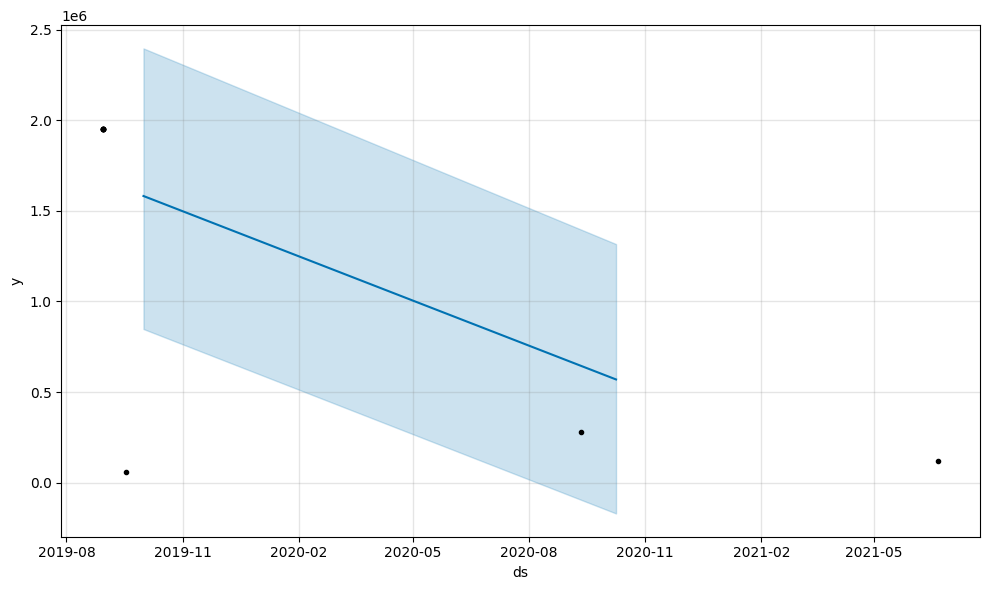

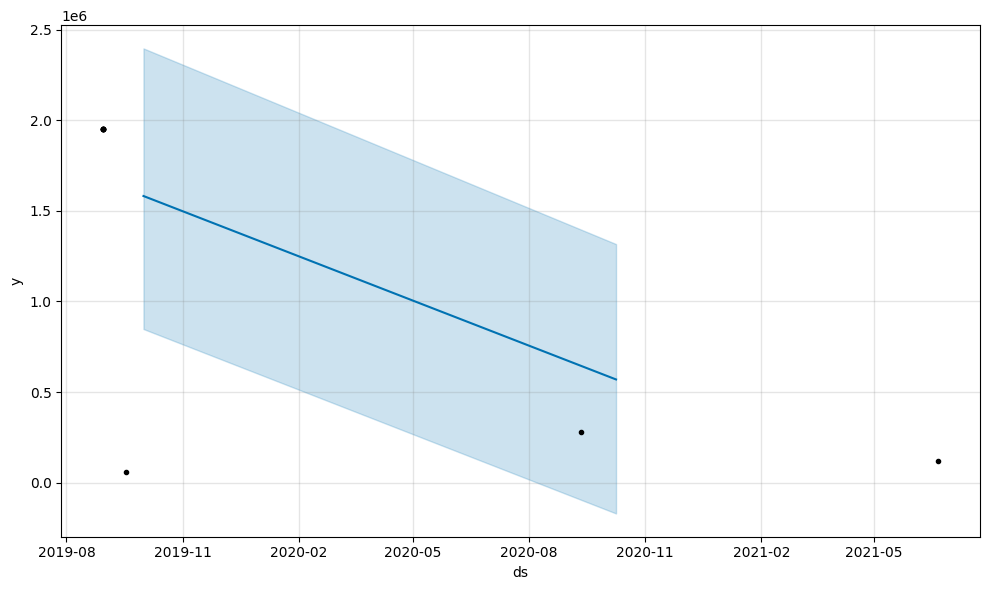

In [ ]:
# models[group].plot(models[group].predict(X_test.groupby(
    ["new_commune", "Type local"]).get_group(group)))